<a href="https://colab.research.google.com/github/cyber-noob/GUISE_AI/blob/main/Guise_ai(Final).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Challenge 1: Classification
In this challenge, you're given a food classification dataset which has 101 classes. You need to analyze and preprocess the dataset as well as build deep learning models for performing food classification. 

You are also required to write a function to apply an augmentation as explained below: <br>
1) Take 5 random images (numpy format) as an input to the function. <br>
2) Randomly arrange the 5 images in a single image while preserving the aspect ratio of each image. <br>
3) Final image size should be an input parameter to the function. <br>
4) Output format shall be numpy format. 
(Note - If required, you can use this augmentation function while training the models). <br>

<br>
Two models are to be trained for this task, mainly light, and medium model. <br>
Examples: <br>
Light model - mobilenetv2 <br>
Medium model - Resnet50 <br>
<br>

**Main Objective**:
You are supposed to use both TensorFlow and PyTorch for this task. You need to train one model for each framework. 

## Summary 

**Create a table for your train and test accuracy as well as speed for each model (mention the framework used for training)**

## Augmentation function given in the problem statement

In [ ]:
import random, os

# Please make sure to run the "Analyse the Datset" block before running this cell(Import the images)
def random_image_generator():
  path = '/content/food-101/images/'     
  random_subdir = random.choice(os.listdir(path))                          
  random_img_path = random.choice([x for x in os.listdir(path + random_subdir)
                if os.path.isfile(os.path.join(path + random_subdir, x))])
  random_img_path = path + random_subdir +'/'+ random_img_path
  return random_img_path

# Analyze the dataset
## Objectives
1. Upload the dataset provided (Google Drive link). 
2. Extract the dataset. 
3. Re-arrange dataset into training and testing folders. 
4. List number of samples in training and testing folders. 
5. Plot sample images from training and testing datasets. 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Your Response/Notes

You can summarize your work for this section here/give any explanations if required. 


In [ ]:
!cp -R '/content/drive/MyDrive/Hiring - Classification Challenge/food-101.zip' '/content/'

In [ ]:
# Extract the dataset
!unzip -o '/content/food-101.zip' -d '/content/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/food-101/images/tacos/1058697.jpg  
  inflating: /content/food-101/images/tacos/1059239.jpg  
  inflating: /content/food-101/images/tacos/1059326.jpg  
  inflating: /content/food-101/images/tacos/1066762.jpg  
  inflating: /content/food-101/images/tacos/1070967.jpg  
  inflating: /content/food-101/images/tacos/1073468.jpg  
  inflating: /content/food-101/images/tacos/1075296.jpg  
  inflating: /content/food-101/images/tacos/1085243.jpg  
  inflating: /content/food-101/images/tacos/108529.jpg  
  inflating: /content/food-101/images/tacos/1086014.jpg  
  inflating: /content/food-101/images/tacos/108945.jpg  
  inflating: /content/food-101/images/tacos/1089575.jpg  
  inflating: /content/food-101/images/tacos/1091159.jpg  
  inflating: /content/food-101/images/tacos/1101369.jpg  
  inflating: /content/food-101/images/tacos/1109058.jpg  
  inflating: /content/food-101/images/tacos/1109744.jpg  
  inflating: /content/f

**Re-arranging dataset into folders**

In [ ]:
import os
import shutil

#Function to re-arrange the dataset

base_dir = '/content/food-101/images/'

def splitter(dir, item, p):

  for (root, dirs, files) in os.walk(base_dir + item):
    for file in files:
      new_dir = '/content/food-101/' + p + '/' + item
      if not os.path.exists(new_dir):
        os.makedirs(new_dir)                      #Creates a folder if its not already present
      if os.path.join(root,file) == dir:
        t = new_dir + '/' + file
        shutil.move(os.path.join(root,file), t)   #Moves the images from one folder to another

In [ ]:
import json

#Driver function to split the images folder to Train/Test folders
def create_train_test(p):                                         # p --> train/test
  base_directory = '/content/food-101/meta/'
  with open(base_directory + p + '.json') as f:
    data = json.load(f)

  for key in data.keys():
    for i in range(len(data[key])):
      splitter(base_dir + data[key][i] + '.jpg', key, p)

In [ ]:
# Function to plot random images
from numpy import expand_dims
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot

def plot_images(path):
  # create image data augmentation generator
  datagen = ImageDataGenerator()
  # prepare iterator
  it = datagen.flow(path, batch_size=1, shuffle = True)
  # generate samples and plot
  for i in range(9):
    # define subplot
    pyplot.subplot(330 + 1 + i)
    # generate batch of images
    batch = it.next()
    # convert to unsigned integers for viewing
    image = batch[0].astype('uint8')
    # plot raw pixel data
    pyplot.imshow(image)
  # show the figure
  pyplot.show()

In [ ]:
# create training data
%%time
p = 'train'
create_train_test(p)

CPU times: user 59.5 s, sys: 26.5 s, total: 1min 25s
Wall time: 1min 25s


In [ ]:
def plot_images(path):
  datagen = ImageDataGenerator( )
  # prepare iterator
  it = datagen.flow_from_directory(path, batch_size=9, shuffle = True)

  def get_key(my_dict,val):
      for key, value in my_dict.items():
          if val == value:
              return key
  
      return "key doesn't exist"

  from skimage import io

  def imshow(image_RGB):
    io.imshow(image_RGB)
    io.show()

  # generate samples and plot
  x, y = it.next()
  x = x.astype(np.uint8)
  pyplot.figure(figsize=(15,8))
  f, axarr = pyplot.subplots(3,3)
  f.set_figheight(15)
  f.set_figwidth(15)
  for i in range(3):
    for j in range(3):
      # define subplot
      count = 1+(j-1)*1+(i-1)*(5)
      # pyplot.imshow(x[i])
      axarr[i,j].imshow(x[count])
      axarr[i,j].title.set_text(get_key(it.class_indices,y[count].argmax()))
  print()
  # show the figure
  pyplot.show()
  x, y = it.next()
  print('x: ',type(x))
  print('y: ', type(y))
  print('image-shape: ', x.shape)
  print('labels-shape: ', y.shape)

In [ ]:
base_directory = '/content/food-101/meta/'
with open(base_directory + 'train' + '.json') as f:
  data = json.load(f)
sum = 0
for key in data.keys():
  path = '/content/food-101/train/' + key
  l = len([f for f in os.listdir(path) 
      if f.endswith('.jpg') and os.path.isfile(os.path.join(path, f))])
  sum += l
print("Total number of samples in train folder: ",sum)

Total number of samples in train folder:  75750


Found 75750 images belonging to 101 classes.



<Figure size 1080x576 with 0 Axes>

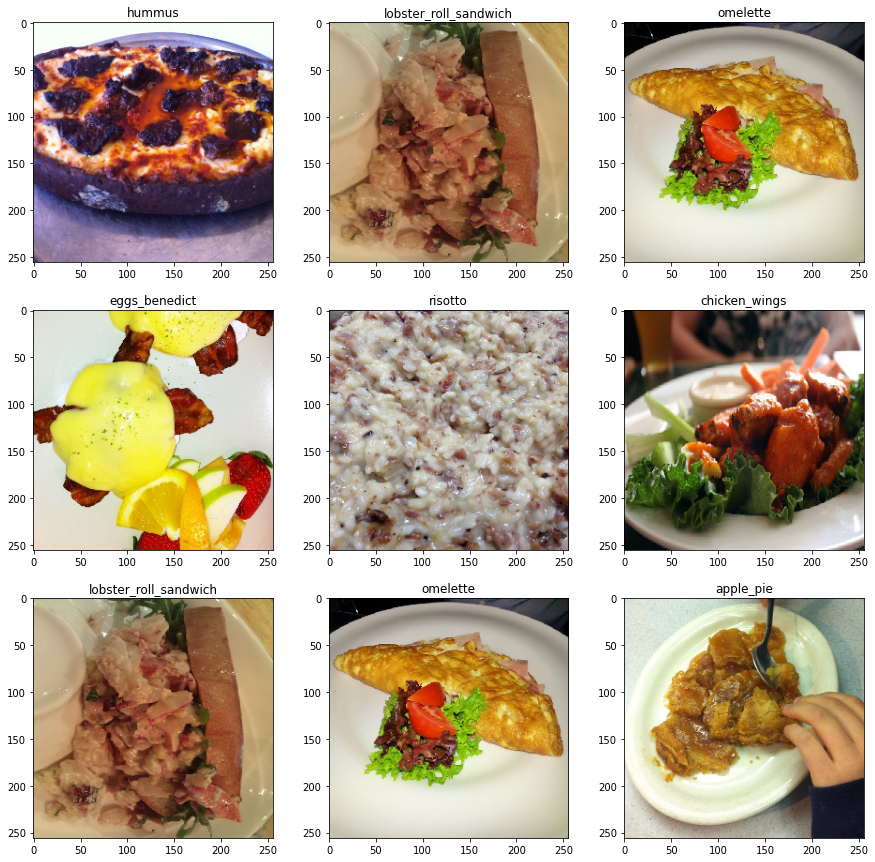

x:  <class 'numpy.ndarray'>
y:  <class 'numpy.ndarray'>
image-shape:  (9, 256, 256, 3)
labels-shape:  (9, 101)


In [ ]:
# Plotting few samples from Train
plot_images('/content/food-101/train')

In [ ]:
# create testing data
%%time
p = 'test'
create_train_test(p)

CPU times: user 10.3 s, sys: 4.94 s, total: 15.3 s
Wall time: 15.2 s


In [ ]:
base_directory = '/content/food-101/meta/'
with open(base_directory + 'test' + '.json') as f:
  data = json.load(f)
sum = 0
for key in data.keys():
  path = '/content/food-101/test/' + key
  l = len([f for f in os.listdir(path) 
      if f.endswith('.jpg') and os.path.isfile(os.path.join(path, f))])
  sum += l
print("Total number of samples in test folder: ",sum)

Total number of samples in test folder:  25250


Found 25250 images belonging to 101 classes.



<Figure size 1080x576 with 0 Axes>

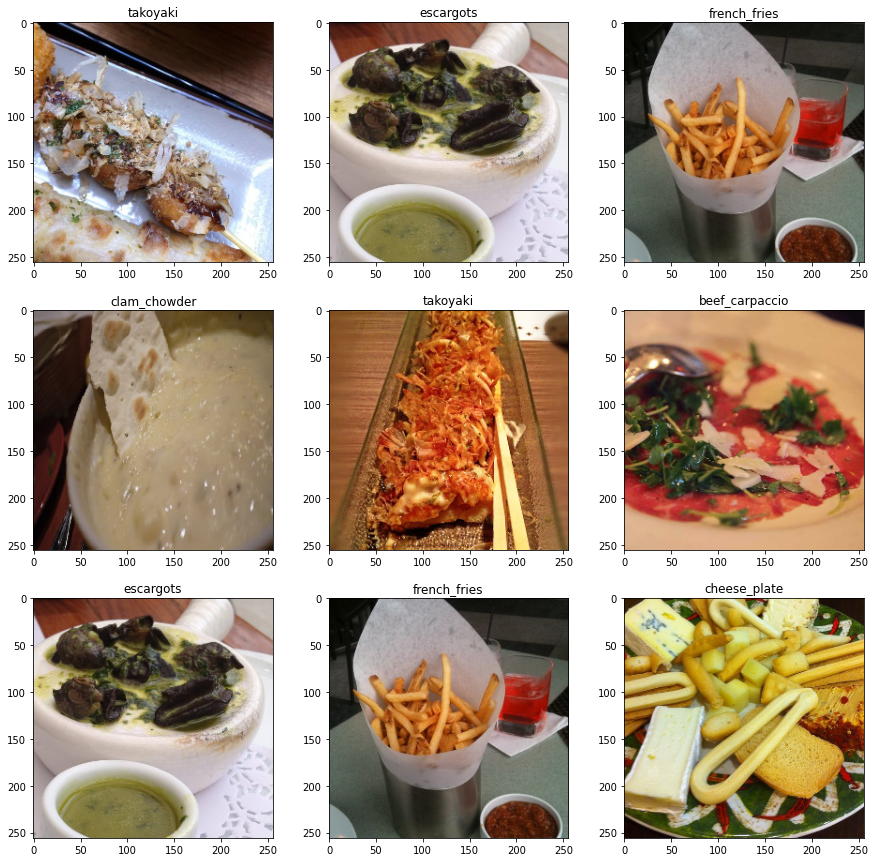

x:  <class 'numpy.ndarray'>
y:  <class 'numpy.ndarray'>
image-shape:  (9, 256, 256, 3)
labels-shape:  (9, 101)


In [ ]:
# Plotting few samples from Test
plot_images('/content/food-101/test')

# Pre-process Images
## Objectives
1. Implement preprocessing codes for each model. 
2. Augment the dataset. 
3. Preview the preprocessed dataset. 

# New Section

### Your Response/Notes

You can summarize your work for this section here/give any explanations if required. 


### Preprocessing steps for light model


In [ ]:
train_path = '/content/food-101/train'
test_path = '/content/food-101/test'

In [ ]:
batch_size = 512
mode = 'categorical'
data_gen = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input,
                              validation_split = 0.2, rotation_range = 60, 
                              shear_range = 0.2, zoom_range = 0.2, horizontal_flip = True)
test_data_gen = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input)
train_batches = data_gen.flow_from_directory(directory = train_path, target_size = (224,224), 
                                             batch_size = batch_size, class_mode = mode, subset = 'training',
                                             shuffle = True)
validation_batches = data_gen.flow_from_directory(directory = train_path, target_size = (224,224), 
                                             batch_size = batch_size, class_mode = mode, subset = 'validation',
                                             shuffle = False)
test_batches = test_data_gen.flow_from_directory(directory = test_path, target_size = (224,224), 
                                             batch_size = batch_size, class_mode = mode)

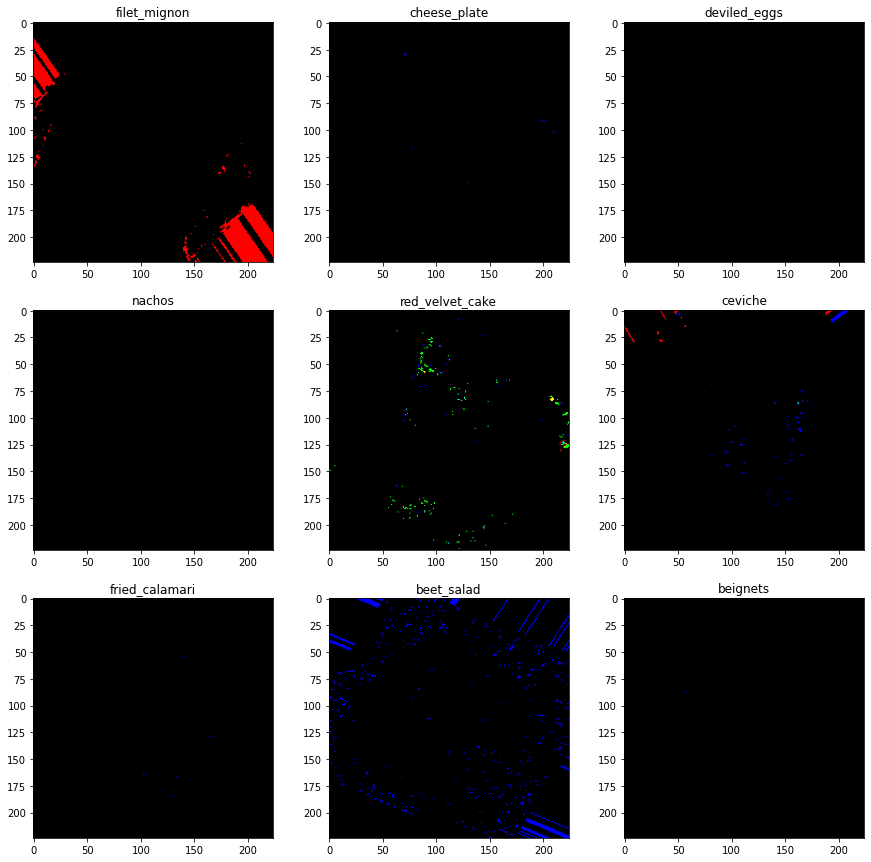

x:  <class 'numpy.ndarray'>
y:  <class 'numpy.ndarray'>
image-shape:  (9, 256, 256, 3)
labels-shape:  (9, 101)


In [ ]:
def get_key(my_dict,val):
    for key, value in my_dict.items():
        if val == value:
            return key

    return "key doesn't exist"

from skimage import io

def imshow(image_RGB):
  io.imshow(image_RGB)
  io.show()

# generate samples and plot
x, y = train_batches.next()
x = x.astype(np.uint8)
f, axarr = pyplot.subplots(3,3)
f.set_figheight(15)
f.set_figwidth(15)
for i in range(3):
  for j in range(3):
    # define subplot
    count = 1+(j-1)*1+(i-1)*(5)
    # pyplot.imshow(x[i])
    axarr[i,j].imshow(x[count])
    axarr[i,j].title.set_text(get_key(it.class_indices,y[count].argmax()))
print()
# show the figure
pyplot.show()
x, y = it.next()
print('x: ',type(x))
print('y: ', type(y))
print('image-shape: ', x.shape)
print('labels-shape: ', y.shape)

### Preprocessing steps for medium model

In [ ]:
from torchvision import transforms
from sklearn.model_selection import train_test_split
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, Subset

batch_size = 128
input_size = (224,224)

# Helper funtion to split Train folder into Train and Validation
def train_val_dataset(dataset, val_split=0.2):
    train_idx, val_idx = train_test_split(list(range(len(dataset))), test_size=val_split)
    datasets = {}
    datasets['train'] = Subset(dataset, train_idx)
    datasets['val'] = Subset(dataset, val_idx)
    return datasets

data_transforms = transforms.Compose([
        transforms.RandomResizedCrop(input_size),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

dataset = ImageFolder(train_path, transform=data_transforms)
print('Number of samples in Train folder: ',len(dataset))
datasets = train_val_dataset(dataset)
print('Number of samples in train (After splitting Train Folder): ',len(datasets['train']))
print('Number of samples in Validation (After splitting Train Folder)',len(datasets['val']))
# The original dataset is available in the Subset class
print(datasets['train'].dataset)

dataloaders_dict = {x:DataLoader(datasets[x],batch_size= 128, shuffle=True, num_workers=0) for x in ['train','val']}
x,y = next(iter(dataloaders_dict['train']))

Number of samples in Train folder:  75750
Number of samples in train (After splitting Train Folder):  60600
Number of samples in Validation (After splitting Train Folder) 15150
Dataset ImageFolder
    Number of datapoints: 75750
    Root location: /content/food-101/train
    StandardTransform
Transform: Compose(
               RandomResizedCrop(size=(224, 224), scale=(0.08, 1.0), ratio=(0.75, 1.3333), interpolation=bilinear)
               RandomHorizontalFlip(p=0.5)
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )


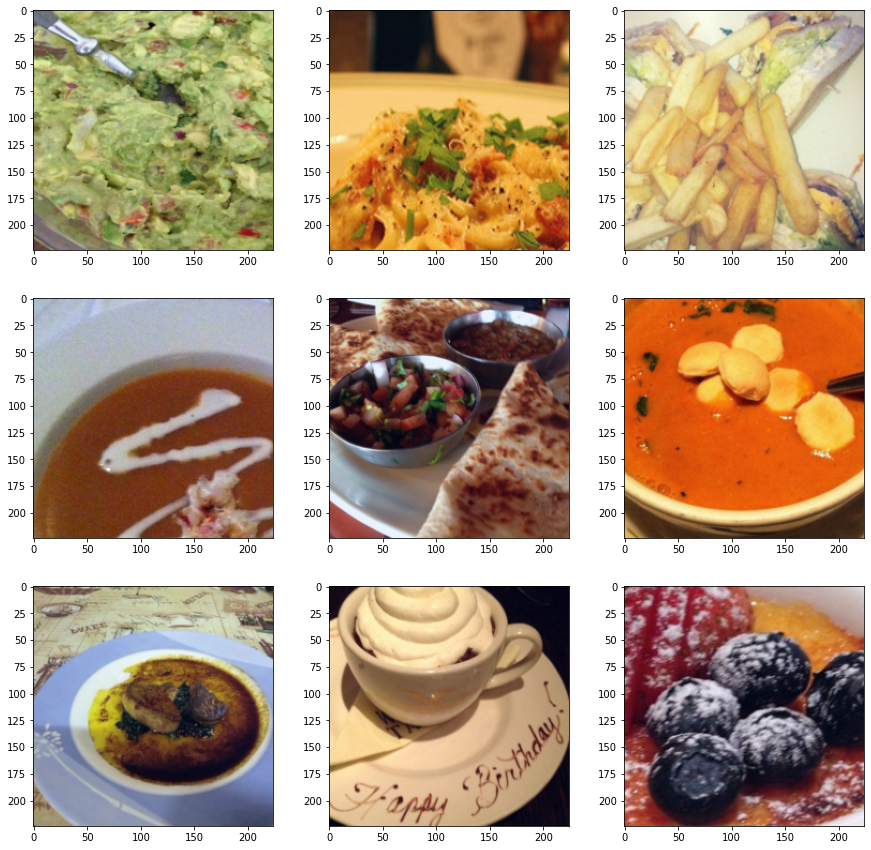

x:  <class 'torch.Tensor'>
y:  <class 'torch.Tensor'>
image-shape:  torch.Size([128, 3, 224, 224])
labels-shape:  torch.Size([128])


In [ ]:
import torchvision
def get_key(my_dict,val):
    for key, value in my_dict.items():
        if val == value:
            return key

    return "key doesn't exist"

from skimage import io

def imshow(image_RGB):
  io.imshow(image_RGB)
  io.show()

# generate samples and plot
x, y = next(iter(dataloaders_dict['train']))
# x = x.astype(np.uint8)
f, axarr = pyplot.subplots(3,3)
f.set_figheight(15)
f.set_figwidth(15)
for i in range(3):
  for j in range(3):
    # define subplot
    count = 1+(j-1)*1+(i-1)*(5)
    # pyplot.imshow(x[i])
    images = x[count]
    images -= images.min()
    images /= images.max()
    axarr[i,j].imshow(torchvision.utils.make_grid(images, nrow=5).permute(1, 2, 0))
print()
# show the figure
pyplot.show()
x, y = next(iter(dataloaders_dict['train']))
print('x: ',type(x))
print('y: ', type(y))
print('image-shape: ', x.shape)
print('labels-shape: ', y.shape)

Preprocessing steps for heavier model

# Training different models
## Objectives
1. Obtain 90% accuracy in all the models trained. 
2. You're free to use any techniques for traning such as transfer learning, knowledge transfer, etc. 
3. The models should not overfit the training dataset. 
4. Measure the performance in terms of accuracy and speed of each model. 
5. Visualize the training and testing performance using TensorBoard. 

#### Optional:
1. Apply weight quantization to increase the speed of the models. 

### Your Response/Notes

You can summarize your work for this section here/give any explanations if required. 


## Train Light model

In [ ]:
!pip install -q tensorflow-gpu

     |████████████████████████████████| 394.3MB 19kB/s 


In [ ]:
!nvidia-smi

Mon Apr 26 07:57:49 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   65C    P0    31W /  70W |    224MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import tensorflow as tf
tf.__version__

'2.4.1'

In [ ]:
import numpy as np
import math
import datetime, os
from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Activation, Flatten, GlobalAveragePooling2D, ReLU, Dropout, Conv2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.applications import imagenet_utils
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
mobile = tf.keras.applications.mobilenet.MobileNet(input_shape = (224,224,3), include_top = True, weights = 'imagenet')
mobile.summary()

17227776/17225924 [==============================] - 0s 0us/step
Model: "mobilenet_1.00_224"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32)      128       
_________________________________________________

In [ ]:
train_path = '/content/food-101/train'
test_path = '/content/food-101/test'

In [ ]:
batch_size = 512
mode = 'categorical'
data_gen = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input,
                              validation_split = 0.2, rotation_range = 60, 
                              shear_range = 0.2, zoom_range = 0.2, horizontal_flip = True)
test_data_gen = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input)
train_batches = data_gen.flow_from_directory(directory = train_path, target_size = (224,224), 
                                             batch_size = batch_size, class_mode = mode, subset = 'training',
                                             shuffle = True)
validation_batches = data_gen.flow_from_directory(directory = train_path, target_size = (224,224), 
                                             batch_size = batch_size, class_mode = mode, subset = 'validation',
                                             shuffle = False)
test_batches = test_data_gen.flow_from_directory(directory = test_path, target_size = (224,224), 
                                             batch_size = batch_size, class_mode = mode)

Found 60600 images belonging to 101 classes.
Found 15150 images belonging to 101 classes.
Found 25250 images belonging to 101 classes.


In [ ]:
x, y = next(train_batches)
print('x: ',type(x))
print('y: ', type(y))
print('x-shape: ', x.shape)
print('y-shape: ', y.shape)

x:  <class 'numpy.ndarray'>
y:  <class 'numpy.ndarray'>
x-shape:  (512, 224, 224, 3)
y-shape:  (512, 101)


In [ ]:
total_layers = len(mobile.layers)
print('Total Number of Layers in MobileNet: ',total_layers)

Total Number of Layers in MobileNet:  92


In [ ]:
for layer in mobile.layers:
  layer.trainable = False

In [ ]:
x = mobile.layers[-3].output
x = Dense(256, activation= 'relu')(x)
x = Dropout(0.2, name = 'custom-dense')(x)
output = Dense(101, activation = 'sigmoid')(x)
output = tf.keras.layers.Reshape((-1,1), name = 'custom-reshape')(output)
# output = tf.keras.layers.Activation('sigmoid')(output)

In [ ]:
model = Model(inputs = mobile.input, outputs = output)

In [ ]:
total_layers = len(model.layers)
print('Total Number of Layers in Custom-MobileNet: ',total_layers)

Total Number of Layers in Custom-MobileNet:  94


In [ ]:
model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
epochs = 5
history = model.fit(train_batches,
                 epochs=epochs, validation_data=validation_batches,
                 callbacks=[tensorboard_callback])

Epoch 1/5
119/119 [==============================] - 1092s 9s/step - loss: 0.2641 - accuracy: 0.9321 - val_loss: 0.0460 - val_accuracy: 0.9903
Epoch 2/5
119/119 [==============================] - 1026s 9s/step - loss: 0.0490 - accuracy: 0.9899 - val_loss: 0.0377 - val_accuracy: 0.9908
Epoch 3/5
119/119 [==============================] - 985s 8s/step - loss: 0.0411 - accuracy: 0.9905 - val_loss: 0.0348 - val_accuracy: 0.9910
Epoch 4/5
119/119 [==============================] - 972s 8s/step - loss: 0.0378 - accuracy: 0.9908 - val_loss: 0.0333 - val_accuracy: 0.9913
Epoch 5/5
119/119 [==============================] - 973s 8s/step - loss: 0.0359 - accuracy: 0.9910 - val_loss: 0.0321 - val_accuracy: 0.9915


In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
!zip -r /content/logs.zip /content/logs

  adding: content/logs/ (stored 0%)
  adding: content/logs/20210426-075928/ (stored 0%)
  adding: content/logs/20210426-075928/train/ (stored 0%)
  adding: content/logs/20210426-075928/train/events.out.tfevents.1619424022.21efaa270acd.profile-empty (deflated 5%)
  adding: content/logs/20210426-075928/train/events.out.tfevents.1619423975.21efaa270acd.57.1864.v2 (deflated 86%)
  adding: content/logs/20210426-075928/train/plugins/ (stored 0%)
  adding: content/logs/20210426-075928/train/plugins/profile/ (stored 0%)
  adding: content/logs/20210426-075928/train/plugins/profile/2021_04_26_08_00_22/ (stored 0%)
  adding: content/logs/20210426-075928/train/plugins/profile/2021_04_26_08_00_22/21efaa270acd.input_pipeline.pb (deflated 56%)
  adding: content/logs/20210426-075928/train/plugins/profile/2021_04_26_08_00_22/21efaa270acd.memory_profile.json.gz (stored 0%)
  adding: content/logs/20210426-075928/train/plugins/profile/2021_04_26_08_00_22/21efaa270acd.overview_page.pb (deflated 56%)
  addi

In [ ]:
from google.colab import files
files.download("/content/logs.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = model.evaluate(test_batches, batch_size=batch_size)
print("test loss, test acc:", results)

Evaluate on test data
50/50 [==============================] - 140s 3s/step - loss: 0.0283 - accuracy: 0.9919
test loss, test acc: [0.028267420828342438, 0.991880476474762]


In [ ]:
def save_model(name):
  # serialize model to JSON
  model_json = model.to_json()
  with open(name + ".json", "w") as json_file:
      json_file.write(model_json)
  # serialize weights to HDF5
  model.save_weights(name + ".h5")
  print("Saved model to disk")

## Train Medium model

In [ ]:
import numpy as np
import torch
import torch.nn as nn
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, Subset
from torchvision.transforms import ToTensor, Resize, Normalize
from torch.optim import lr_scheduler
from torch import optim
from torchvision import transforms
from sklearn.model_selection import train_test_split
import time
import copy
import torchvision.models as models
from torchsummary import summary

In [ ]:
train_path = '/content/food-101/train'
test_path = '/content/food-101/test'

In [ ]:
def train_model(model, dataloaders, criterion, optimizer, num_epochs=25, is_inception=False):
    since = time.time()

    val_acc_history = []

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss
                    # Special case for inception because in training it has an auxiliary output. In train
                    #   mode we calculate the loss by summing the final output and the auxiliary output
                    #   but in testing we only consider the final output.
                    if is_inception and phase == 'train':
                        outputs, aux_outputs = model(inputs)
                        loss1 = criterion(outputs, labels)
                        loss2 = criterion(aux_outputs, labels)
                        loss = loss1 + 0.4*loss2
                    else:
                        outputs = model(inputs)
                        labels = torch.nn.funtional.one_hot(labels)
                        loss = criterion(outputs, labels)

                    _, preds = torch.max(outputs, 1)
                    
                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_acc = running_corrects.double() / len(dataloaders[phase].dataset)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
            if phase == 'val':
                val_acc_history.append(epoch_acc)

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, val_acc_history

In [ ]:
def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False

In [ ]:
from torch.nn.init import kaiming_uniform_
from torch.nn.init import xavier_uniform_
from torch.nn import Module
# model definition
class MLP(Module):
    # define model elements
    def __init__(self, n_inputs, num_classes):
        super(MLP, self).__init__()
        # input to first hidden layer
        self.hidden1 = nn.Linear(n_inputs, 256)
        self.act1 = nn.ReLU()
        self.hidden3 = nn.Linear(256, num_classes)
        self.act3 = nn.LogSoftmax(dim=1)
 
    # forward propagate input
    def forward(self, X):
        # input to first hidden layer
        X = self.hidden1(X)
        X = self.act1(X)
        X = self.hidden3(X)
        X = self.act3(X)
        return X

In [ ]:
# Flag for feature extracting. When False, we finetune the whole model,
#   when True we only update the reshaped layer params
feature_extract = True
# Number of classes/ Target
num_classes = 101

def initialize_model(num_classes, feature_extract, use_pretrained = True):
  model_ft = models.resnet18(pretrained=use_pretrained)
  set_parameter_requires_grad(model_ft, feature_extract)
  num_ftrs = model_ft.fc.in_features
  model_ft.fc = MLP(num_ftrs, num_classes)
  input_size = 224

  return model_ft, input_size

# Initialize the model for this run
model_ft, input_size = initialize_model(num_classes , feature_extract, use_pretrained = True)

# Print the model we just instantiated
print(model_ft)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
batch_size = 128

# Helper funtion to split Train folder into Train and Validation
def train_val_dataset(dataset, val_split=0.2):
    train_idx, val_idx = train_test_split(list(range(len(dataset))), test_size=val_split)
    datasets = {}
    datasets['train'] = Subset(dataset, train_idx)
    datasets['val'] = Subset(dataset, val_idx)
    return datasets

# Data augmentation and normalization for training
# Just normalization for validation
data_transforms = transforms.Compose([
        transforms.RandomRotation(30),
        transforms.RandomResizedCrop(input_size),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

print("Initializing Datasets and Dataloaders...")

dataset = ImageFolder(train_path, transform=data_transforms)
print('Number of samples in Train folder: ',len(dataset))
datasets = train_val_dataset(dataset)
print('Number of samples in train (After splitting Train Folder): ',len(datasets['train']))
print('Number of samples in Validation (After splitting Train Folder)',len(datasets['val']))
# The original dataset is available in the Subset class
print(datasets['train'].dataset)

dataloaders_dict = {x:DataLoader(datasets[x],batch_size= 128, shuffle=True, num_workers=0) for x in ['train','val']}
x,y = next(iter(dataloaders_dict['train']))
print(x.shape, y.shape)

# Detect if we have a GPU available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Initializing Datasets and Dataloaders...
Number of samples in Train folder:  75750
Number of samples in train (After splitting Train Folder):  60600
Number of samples in Validation (After splitting Train Folder) 15150
Dataset ImageFolder
    Number of datapoints: 75750
    Root location: /content/food-101/train
    StandardTransform
Transform: Compose(
               RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)
               RandomResizedCrop(size=(224, 224), scale=(0.08, 1.0), ratio=(0.75, 1.3333), interpolation=bilinear)
               RandomHorizontalFlip(p=0.5)
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )
torch.Size([128, 3, 224, 224]) torch.Size([128])


In [ ]:
!nvidia-smi

Mon Apr 26 10:45:30 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   66C    P0    31W /  70W |   2024MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# Optimizer

# Send the model to GPU
model_ft = model_ft.to(device)

# Gather the parameters to be optimized/updated in this run. If we are
#  finetuning we will be updating all parameters. However, if we are
#  doing feature extract method, we will only update the parameters
#  that we have just initialized, i.e. the parameters with requires_grad
#  is True.
params_to_update = model_ft.parameters()
print("Params to learn:")
if feature_extract:
    params_to_update = []
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            params_to_update.append(param)
            print("\t",name)
else:
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            print("\t",name)

# Observe that all parameters are being optimized
test_params = list(model_ft.layer4.parameters()) + list(model_ft.fc.parameters())
optimizer_ft = optim.Adam(model_ft.classifier.parameters(), lr=0.001)

Params to learn:
	 classifier.fc1.weight
	 classifier.fc1.bias
	 classifier.fc2.weight
	 classifier.fc2.bias


In [ ]:
# Models to choose from [resnet, alexnet, vgg, squeezenet, densenet, inception]
model_name = "resnet50"

# Number of epochs to train for
num_epochs = 15

# Flag for feature extracting. When False, we finetune the whole model,
#   when True we only update the reshaped layer params
feature_extract = True

# Setup the loss fxn
criterion = nn.CrossEntropyLoss()

# Train and evaluate
model_ft, hist = train_model(model_ft, dataloaders_dict, criterion, optimizer_ft, num_epochs=num_epochs, is_inception=(model_name=="inception"))

In [ ]:
torch.save(model_ft.state_dict,'/content/resnet50_dict.pt')

In [ ]:
# !killall5 -9          # Please use this function if there is a Cuda Error for memory exhaustion

**Results**

,Training_Loss,Training_Acc,Val_Loss,Val_Acc
MobileNet,0.0359,0.9910,0.0321,0.9915
ResNet50,2.3201,0.5217,2.5016,0.5297


# End Notes

**Results for Tensorflow Model (MobileNet)**

After shear amount of fine tuning the model was pushed to its limits by achieving an accuracy of 99% in all the Training, Validation and Test set consistently proving that the model is not over fit but it is indeed predicting with an accuracy of 99%

**Results for Pytorch Model (ResNet50)**

After a few epochs the model loss and accuracy doesn't seem to show a lot of improvement but I believe that if the model runs for more than 25 epochs, it would be able to achieve the 90% accuracy mark and since each epoch takes nearly 15mins in my system I couldn't test it myself and I apologise for that.
